In [1]:
import keras
import tensorflow as tf
import gdal
import os
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path
from keras_unet.models import custom_unet, satellite_unet
from keras_unet.metrics import iou, iou_thresholded
from keras_unet.losses import jaccard_distance
from keras_unet.utils import plot_segm_history

2023-07-19 15:09:32.358058: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-07-19 15:09:32.378883: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-07-19 15:09:32.497156: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-07-19 15:09:32.498288: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-19 15:09:33.369154: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Co

-----------------------------------------
keras-unet init: TF version is >= 2.0.0 - using `tf.keras` instead of `Keras`
-----------------------------------------


In [2]:
base_dir = Path(r'/media/studentuser/Seagate Portable Drive/training')
mask_dir = base_dir.joinpath('masks_img')
image_dir = base_dir.joinpath('img')
water_dir = mask_dir.joinpath('water_img')
shrubs_dir = mask_dir.joinpath('shrubs_img')
trees_dir = mask_dir.joinpath('trees_img')
low_dir = mask_dir.joinpath('low_density_img')

In [3]:
# alter unet code from package
from keras_unet import TF
if TF:
    from tensorflow.keras.models import Model
    from tensorflow.keras.layers import ( 
        BatchNormalization, Conv2D, Conv2DTranspose,
        MaxPooling2D, UpSampling2D, Input,
        concatenate
    )
else:    
    from keras.models import Model
    from keras.layers import ( 
        BatchNormalization, Conv2D, Conv2DTranspose,
        MaxPooling2D, UpSampling2D, Input,
        concatenate
    )


def bn_conv_relu(input, filters, bachnorm_momentum, **conv2d_args):
    x = BatchNormalization(momentum=bachnorm_momentum)(input)
    x = Conv2D(filters, **conv2d_args)(x)
    return x

def bn_upconv_relu(input, filters, bachnorm_momentum, **conv2d_trans_args):
    x = BatchNormalization(momentum=bachnorm_momentum)(input)
    x = Conv2DTranspose(filters, **conv2d_trans_args)(x)
    return x

def satellite_unet2(
    input_shape,
    num_classes=1,
    output_activation='sigmoid',
    num_layers=4):

    inputs = Input(input_shape)   
    
    filters = 64
    upconv_filters = 96

    kernel_size = (5,5)
    activation = 'relu'
    strides = (1,1)
    padding = 'same'
    kernel_initializer = 'he_normal'

    conv2d_args = {
        'kernel_size':kernel_size,
        'activation':activation, 
        'strides':strides,
        'padding':padding,
        'kernel_initializer':kernel_initializer
        }

    conv2d_trans_args = {
        'kernel_size':kernel_size,
        'activation':activation, 
        'strides':(2,2),
        'padding':padding,
        'output_padding':(1,1)
        }

    bachnorm_momentum = 0.01

    pool_size = (2,2)
    pool_strides = (2,2)
    pool_padding = 'valid'

    maxpool2d_args = {
        'pool_size':pool_size,
        'strides':pool_strides,
        'padding':pool_padding,
        }
    
    x = Conv2D(filters, **conv2d_args)(inputs)
    c1 = bn_conv_relu(x, filters, bachnorm_momentum, **conv2d_args)    
    x = bn_conv_relu(c1, filters, bachnorm_momentum, **conv2d_args)
    x = MaxPooling2D(**maxpool2d_args)(x)

    down_layers = []

    for l in range(num_layers):
        x = bn_conv_relu(x, filters, bachnorm_momentum, **conv2d_args)
        x = bn_conv_relu(x, filters, bachnorm_momentum, **conv2d_args)
        down_layers.append(x)
        x = bn_conv_relu(x, filters, bachnorm_momentum, **conv2d_args)
        x = MaxPooling2D(**maxpool2d_args)(x)

    x = bn_conv_relu(x, filters, bachnorm_momentum, **conv2d_args)
    x = bn_conv_relu(x, filters, bachnorm_momentum, **conv2d_args)
    x = bn_upconv_relu(x, filters, bachnorm_momentum, **conv2d_trans_args)

    for conv in reversed(down_layers):        
        x = concatenate([x, conv])  
        x = bn_conv_relu(x, upconv_filters, bachnorm_momentum, **conv2d_args)
        x = bn_conv_relu(x, filters, bachnorm_momentum, **conv2d_args)
        x = bn_upconv_relu(x, filters, bachnorm_momentum, **conv2d_trans_args)

    x = concatenate([x, c1])
    x = bn_conv_relu(x, upconv_filters, bachnorm_momentum, **conv2d_args)
    x = bn_conv_relu(x, filters, bachnorm_momentum, **conv2d_args)
           
    outputs = Conv2D(num_classes, kernel_size=(1,1), strides=(1,1), activation=output_activation, padding='valid') (x)       
    
    model = Model(inputs=[inputs], outputs=[outputs])
    return model

In [4]:
def make_path(img_dir, prefix, number):
    return os.path.join(img_dir, f"{prefix}_{number}.tif")

In [5]:
def img_number(fpath: str) -> int:
    return int(os.path.splitext(os.path.split(fpath)[1])[0].split('_')[-1])

In [6]:
def load_image(path: str) -> np.ndarray:
    ds = gdal.Open(path, gdal.GA_ReadOnly)
    return ds.GetRasterBand(1).ReadAsArray()

In [7]:
def load_stack(shape, dtype, img_dir, prefix):
    stack = np.zeros(shape = shape, dtype = dtype)
    for i in range(shape[0]):
        image_path = make_path(img_dir, prefix, i + 1)
        stack[i, :, :] = load_image(image_path)
    return stack

def load_stack_safely(shape, dtype, img_dir, prefix):
    stack = np.zeros(shape = shape, dtype = dtype)
    for i in range(shape[0]):
        image_path = make_path(img_dir, prefix, i + 1)
        if not os.path.isfile(image_path):
            print("skipping", image_path)
            continue
        stack[i, :, :] = load_image(image_path)
    return stack

In [8]:
I = 400
N = 256
M = 256
V = 4

In [9]:
train_images = load_stack((I, N, M), np.float32, image_dir, "img")
train_images_R = train_images.reshape(I, N, M, 1)

In [10]:
train_images_R.shape

(400, 256, 256, 1)

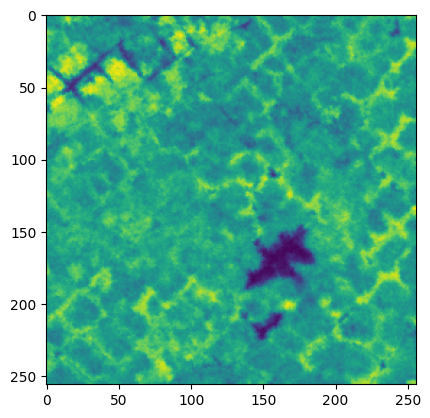

In [11]:
plt.imshow(train_images[1, :,:])

In [12]:
water_mask = load_stack_safely((I, N, M), np.int8, water_dir, "water")
trees_mask = load_stack_safely((I, N, M), np.int8, trees_dir, "tree")
shrubs_mask = load_stack_safely((I, N, M), np.int8, shrubs_dir, "shrub")
low_mask = load_stack_safely((I, N, M), np.int8, low_dir, "low")

skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_2.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_7.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_10.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_13.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_15.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_22.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_23.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_24.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_35.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_38.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/wa

skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_277.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_279.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_280.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_282.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_283.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_286.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_287.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_296.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_297.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_300.tif
skipping /media/studentuser/Seagate Portable Drive/training/

skipping /media/studentuser/Seagate Portable Drive/training/masks_img/trees_img/tree_85.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/trees_img/tree_86.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/trees_img/tree_87.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/trees_img/tree_88.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/trees_img/tree_89.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/trees_img/tree_91.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/trees_img/tree_92.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/trees_img/tree_95.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/trees_img/tree_96.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/trees_img/tree_97.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/trees_img/

skipping /media/studentuser/Seagate Portable Drive/training/masks_img/trees_img/tree_246.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/trees_img/tree_247.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/trees_img/tree_248.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/trees_img/tree_249.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/trees_img/tree_251.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/trees_img/tree_253.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/trees_img/tree_254.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/trees_img/tree_256.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/trees_img/tree_258.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/trees_img/tree_260.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/

skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_13.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_15.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_19.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_22.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_23.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_25.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_27.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_28.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_32.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_34.tif
skipping /media/studentuser/Seagate Portable Drive/training/

skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_177.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_178.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_179.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_181.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_187.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_189.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_191.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_194.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_195.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_196.tif
skipping /media/studentuser/Seagate Portable Drive

skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_391.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_392.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_393.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_394.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_396.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_397.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_398.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_399.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_1.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_2.tif
skipping /media/studentuser/Seagate Portable Dri

skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_143.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_144.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_145.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_146.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_147.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_148.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_149.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_150.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_151.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_152.tif
skipping /media/stud

skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_368.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_369.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_370.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_371.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_372.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_373.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_374.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_375.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_376.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/low_density_img/low_377.tif
skipping /media/stud

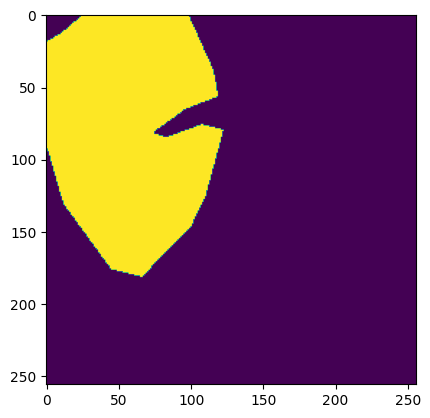

In [13]:
plt.imshow(low_mask[365, :,:])

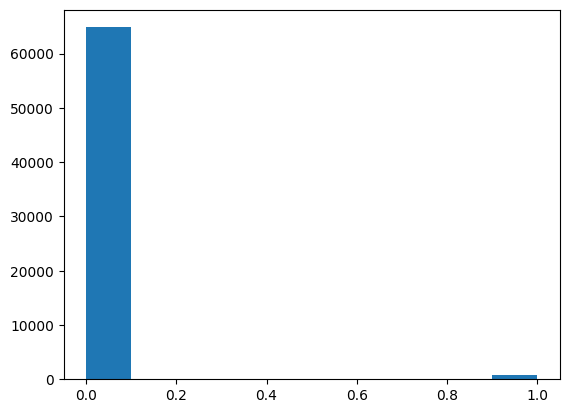

In [14]:
plt.hist(water_mask[0, :,:].flatten())
plt.show()

In [15]:
model = satellite_unet2((N, M, 1), V)

2023-07-19 15:10:03.803201: W tensorflow/core/common_runtime/gpu/gpu_device.cc:1956] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


In [16]:
model.compile(
    optimizer = tf.keras.optimizers.Adam(),
    loss = "binary_crossentropy",
    metrics = [iou, iou_thresholded],
)

In [17]:
# Images 13, 174 held out due to low image quality from smoke

W = 358
Y = np.zeros(shape=(W, N, M, V), dtype =np.int8)
Y_train_img = np.zeros(shape=(W, N, M, 1), dtype =np.float32)

Y[0:12, :, :, 0] = trees_mask[0:12, :, :]
Y[0:12, :, :, 1] = water_mask[0:12, :, :]
Y[0:12, :, :, 2] = shrubs_mask[0:12, :, :]
Y[0:12, :, :, 3] = low_mask[0:12, :, :]
Y_train_img[0:12, :, :, 0] = train_images_R[0:12, :, :, 0]

Y[12:173, :, :, 0] = trees_mask[13:174, :, :]
Y[12:173, :, :, 1] = water_mask[13:174, :, :]
Y[12:173, :, :, 2] = shrubs_mask[13:174, :, :]
Y[12:173, :, :, 3] = low_mask[13:174, :, :]
Y_train_img[12:173, :, :, 0] = train_images_R[13:174, :, :, 0]

Y[173:W, :, :, 0] = trees_mask[175:W+2, :, :]
Y[173:W, :, :, 1] = water_mask[175:W+2, :, :]
Y[173:W, :, :, 2] = shrubs_mask[175:W+2, :, :]
Y[173:W, :, :, 3] = low_mask[175:W+2, :, :]
Y_train_img[173:W, :, :, 0] = train_images_R[175:W+2, :, :, 0]

In [18]:
K = 40
Y_valid = np.zeros(shape=(K, N, M, V), dtype =np.int8)
Y_valid_img = np.zeros(shape=(K, N, M, 1), dtype =np.float32)

Y_valid[0:K, :, :, 0] = trees_mask[I-K:I, :, :]
Y_valid[0:K, :, :, 1] = water_mask[I-K:I, :, :]
Y_valid[0:K, :, :, 2] = shrubs_mask[I-K:I, :, :]
Y_valid[0:K, :, :, 3] = low_mask[I-K:I, :, :]
Y_valid_img[0:K, :, :, 0] = train_images_R[I-K:I, :, :, 0]

In [19]:
low_mask[46, :,:]

array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1]], dtype=int8)

In [20]:
Y[45,:,:,3]

array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1]], dtype=int8)

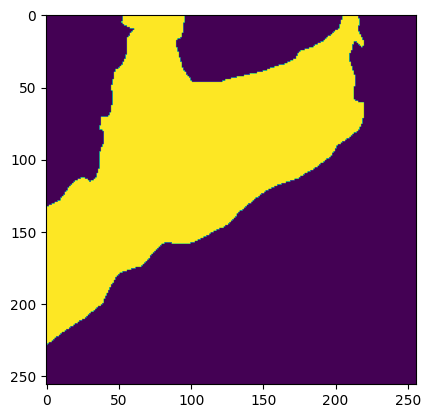

In [21]:
plt.imshow(Y[3,:,:,2])

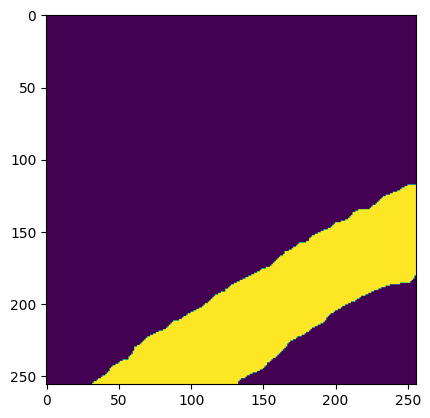

In [22]:
plt.imshow(water_mask[3,:, :])

In [23]:
Y_valid_img.shape

(40, 256, 256, 1)

In [24]:
Y.shape

(358, 256, 256, 4)

In [25]:
history = model.fit(Y_train_img, Y, epochs = 200)

Epoch 1/200
12/12 [==============================] - 103s 8s/step - loss: 0.3809 - iou: 0.1959 - iou_thresholded: 0.2279
Epoch 2/200
12/12 [==============================] - 95s 8s/step - loss: 0.2944 - iou: 0.1970 - iou_thresholded: 0.2308
Epoch 3/200
12/12 [==============================] - 94s 8s/step - loss: 0.2428 - iou: 0.2591 - iou_thresholded: 0.2906
Epoch 4/200
12/12 [==============================] - 95s 8s/step - loss: 0.2444 - iou: 0.2728 - iou_thresholded: 0.3028
Epoch 5/200
12/12 [==============================] - 95s 8s/step - loss: 0.2284 - iou: 0.3033 - iou_thresholded: 0.3573
Epoch 6/200
12/12 [==============================] - 96s 8s/step - loss: 0.2082 - iou: 0.3092 - iou_thresholded: 0.3658
Epoch 7/200
12/12 [==============================] - 96s 8s/step - loss: 0.1818 - iou: 0.3308 - iou_thresholded: 0.4204
Epoch 8/200
12/12 [==============================] - 95s 8s/step - loss: 0.1729 - iou: 0.3795 - iou_thresholded: 0.4473
Epoch 9/200
12/12 [====================

12/12 [==============================] - 93s 8s/step - loss: 0.1226 - iou: 0.5133 - iou_thresholded: 0.6021
Epoch 69/200
12/12 [==============================] - 92s 8s/step - loss: 0.1111 - iou: 0.5235 - iou_thresholded: 0.6435
Epoch 70/200
12/12 [==============================] - 93s 8s/step - loss: 0.1074 - iou: 0.5305 - iou_thresholded: 0.6402
Epoch 71/200
12/12 [==============================] - 92s 8s/step - loss: 0.1105 - iou: 0.5360 - iou_thresholded: 0.6394
Epoch 72/200
12/12 [==============================] - 93s 8s/step - loss: 0.1267 - iou: 0.5044 - iou_thresholded: 0.6065
Epoch 73/200
12/12 [==============================] - 93s 8s/step - loss: 0.1156 - iou: 0.5056 - iou_thresholded: 0.6164
Epoch 74/200
12/12 [==============================] - 92s 8s/step - loss: 0.1204 - iou: 0.5095 - iou_thresholded: 0.5978
Epoch 75/200
12/12 [==============================] - 93s 8s/step - loss: 0.1103 - iou: 0.5313 - iou_thresholded: 0.6551
Epoch 76/200
12/12 [=========================

12/12 [==============================] - 92s 8s/step - loss: 0.0935 - iou: 0.6000 - iou_thresholded: 0.7049
Epoch 136/200
12/12 [==============================] - 92s 8s/step - loss: 0.0844 - iou: 0.6082 - iou_thresholded: 0.7056
Epoch 137/200
12/12 [==============================] - 92s 8s/step - loss: 0.0853 - iou: 0.6143 - iou_thresholded: 0.7249
Epoch 138/200
12/12 [==============================] - 93s 8s/step - loss: 0.0867 - iou: 0.6174 - iou_thresholded: 0.7114
Epoch 139/200
12/12 [==============================] - 93s 8s/step - loss: 0.0949 - iou: 0.6114 - iou_thresholded: 0.7064
Epoch 140/200
12/12 [==============================] - 93s 8s/step - loss: 0.0893 - iou: 0.5895 - iou_thresholded: 0.6857
Epoch 141/200
12/12 [==============================] - 92s 8s/step - loss: 0.0863 - iou: 0.6178 - iou_thresholded: 0.7222
Epoch 142/200
12/12 [==============================] - 93s 8s/step - loss: 0.0813 - iou: 0.6245 - iou_thresholded: 0.7313
Epoch 143/200
12/12 [=================

In [34]:
modelsave_path = Path(r'/media/studentuser/Seagate Portable Drive/predictions_71/model_kernal')

In [35]:
model.save(modelsave_path)

2023-07-20 09:28:49.149398: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'inputs' with dtype float and shape [?,?,?,64]
	 [[{{node inputs}}]]
2023-07-20 09:28:49.241121: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'inputs' with dtype float and shape [?,?,?,64]
	 [[{{node inputs}}]]
2023-07-20 09:28:49.341007: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'inputs' with dtype float and shape [?,?,?,64]
	 [[{{node inputs}}]]
2023-07

INFO:tensorflow:Assets written to: /media/studentuser/Seagate Portable Drive/predictions_71/model_kernal/assets


INFO:tensorflow:Assets written to: /media/studentuser/Seagate Portable Drive/predictions_71/model_kernal/assets


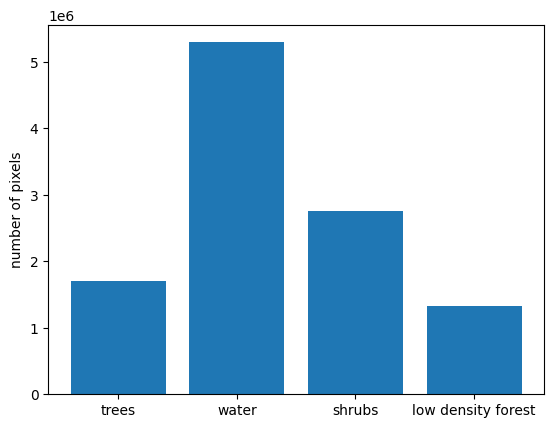

In [30]:
fig, ax = plt.subplots()
ax.bar(range(V), [trees_mask.sum(), water_mask.sum(), shrubs_mask.sum(), low_mask.sum()])
ax.set_xticks((0, 1, 2, 3))
ax.set_xticklabels(('trees', 'water', 'shrubs', 'low density forest'))
plt.ylabel('number of pixels')
plt.show()

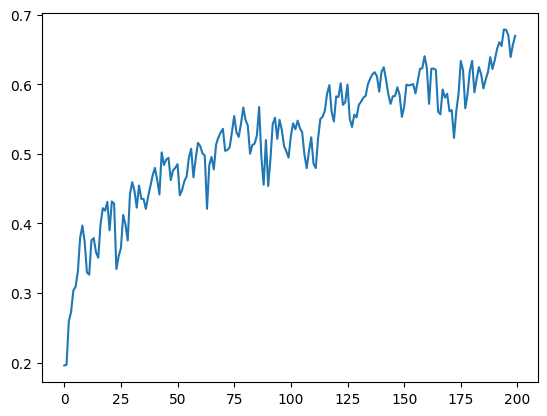

In [31]:
plt.plot(history.history['iou'])

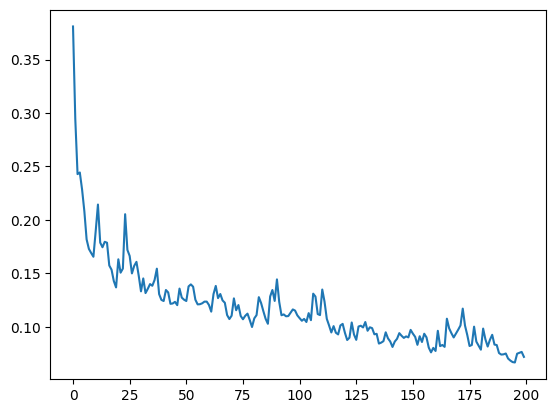

In [32]:
plt.plot(history.history['loss'])

In [33]:
Y_pred = model.predict(Y_train_img)

12/12 [==============================] - 55s 4s/step


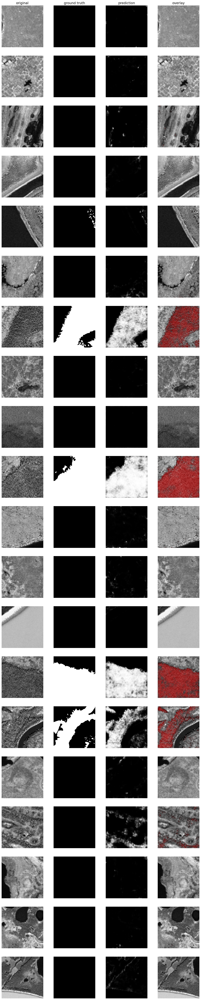

In [36]:
from keras_unet.utils import plot_imgs

# Trees
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 0], 
    pred_imgs=Y_pred[:, :, :, 0], 
    nm_img_to_plot=20
  )

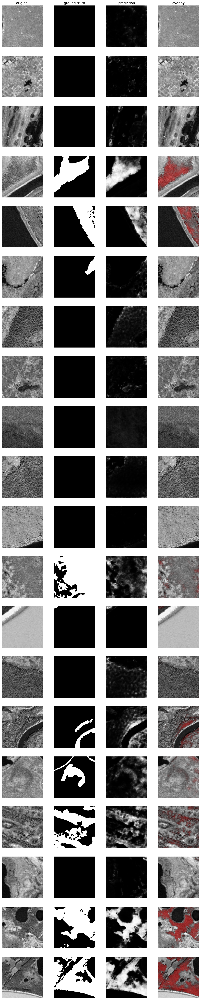

In [37]:
# Water
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 1], 
    pred_imgs=Y_pred[:, :, :, 1], 
    nm_img_to_plot=20
  )

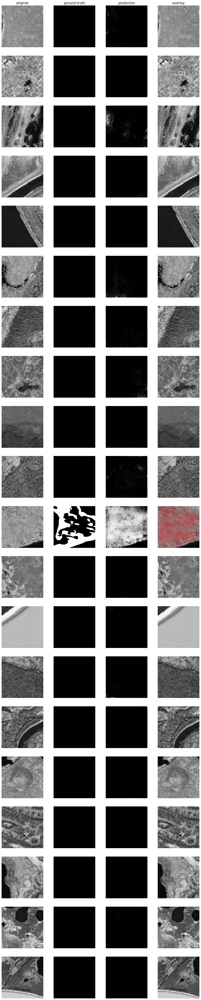

In [38]:
# Shrubs
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 2], 
    pred_imgs=Y_pred[:, :, :, 2], 
    nm_img_to_plot=20
  )

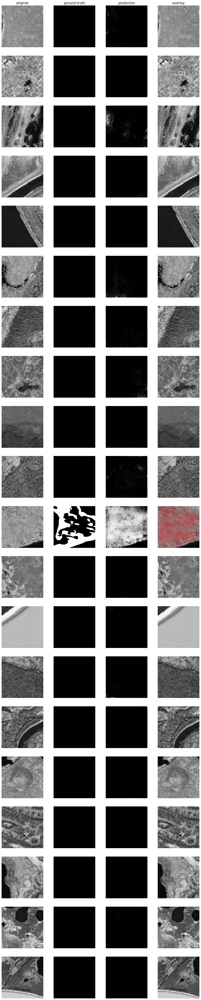

In [39]:
# Low density forest
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 3], 
    pred_imgs=Y_pred[:, :, :, 3], 
    nm_img_to_plot=20
  )

In [40]:
valid_pred = model.predict(Y_valid_img)

2/2 [==============================] - 7s 1s/step


In [41]:
valid_pred[1,:, :, 0]

array([[1.06306439e-02, 4.88267792e-03, 1.53609074e-03, ...,
        2.36695586e-03, 5.41714905e-03, 1.91917773e-02],
       [3.66074918e-03, 1.65563356e-03, 5.89374511e-04, ...,
        2.42663943e-03, 3.36956535e-03, 9.23193060e-03],
       [1.46906869e-03, 1.03518693e-03, 2.42738228e-04, ...,
        7.11144938e-04, 1.98252057e-03, 6.93261158e-03],
       ...,
       [3.08760315e-01, 2.96679974e-01, 3.25067639e-01, ...,
        4.16821688e-02, 3.66174616e-02, 1.14123695e-01],
       [2.88298279e-01, 2.74342805e-01, 3.09971660e-01, ...,
        7.83139989e-02, 9.08710435e-02, 1.32097900e-01],
       [2.25653350e-01, 2.80589461e-01, 2.64433742e-01, ...,
        9.83653814e-02, 1.64505601e-01, 2.42464632e-01]], dtype=float32)

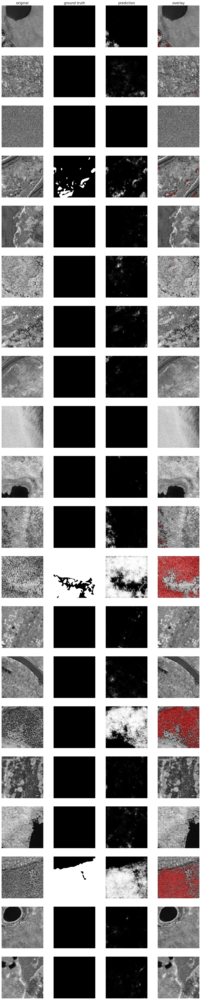

In [42]:
# Trees
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 0], 
    pred_imgs=valid_pred[:, :, :, 0], 
    nm_img_to_plot=20
  )

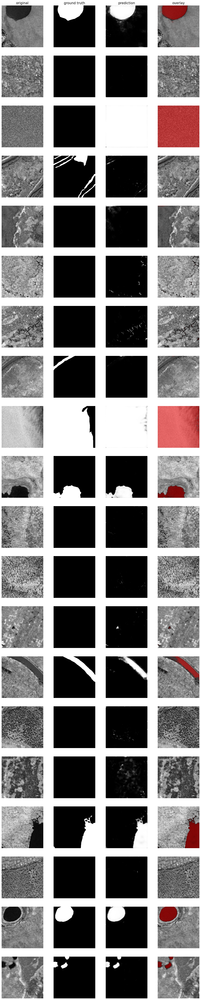

In [43]:
# Water
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 1], 
    pred_imgs=valid_pred[:, :, :, 1], 
    nm_img_to_plot=20
  )

In [44]:
waterPredict = valid_pred[:,:,:,1]

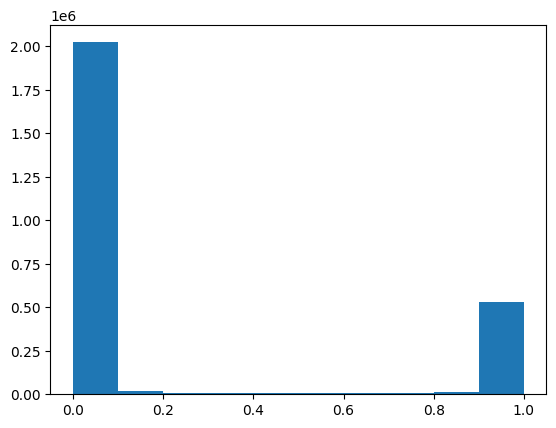

In [45]:
plt.hist(waterPredict.flatten())
plt.show()

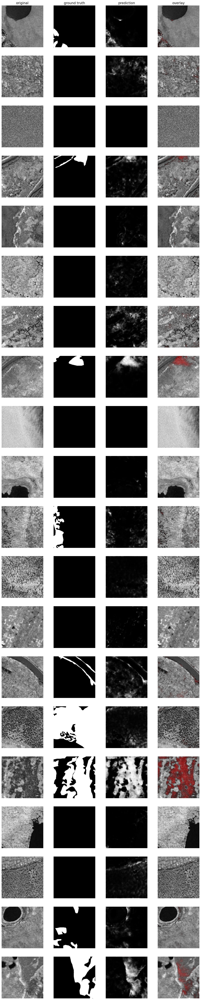

In [48]:
# Shrubs
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 2], 
    pred_imgs=valid_pred[:, :, :, 2], 
    nm_img_to_plot=20
  )

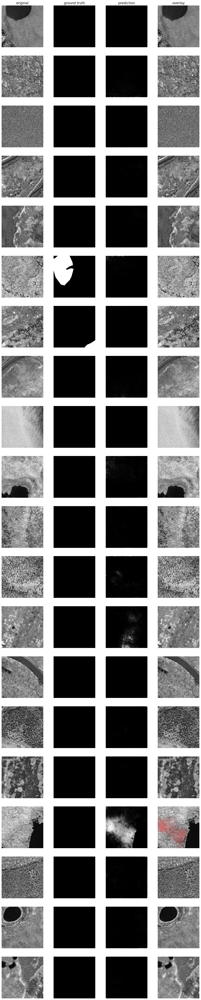

In [49]:
# Low density forest
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 3], 
    pred_imgs=valid_pred[:, :, :, 3], 
    nm_img_to_plot=20
  )

In [50]:
plt.hist(treePredict.flatten())
plt.show()

NameError: name 'treePredict' is not defined

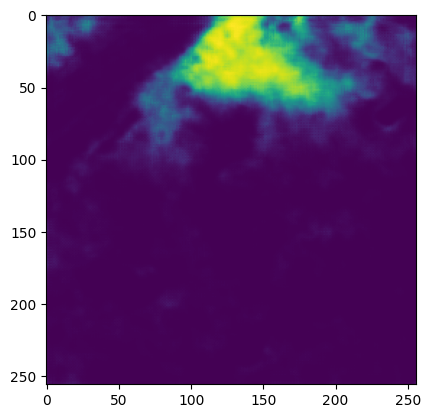

In [51]:
plt.imshow(valid_pred[7,:, :,2])

In [52]:
J, N, M = 400, 256, 256

In [53]:
driver = gdal.GetDriverByName("GTiff")

In [54]:
driver.Register()

2

In [72]:
def save_predict_validT( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(360,400):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(valid_pred[i-360,:,:,0])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None

In [73]:
tree_valid_dir = r'/media/studentuser/Seagate Portable Drive/predictions_71/kernalmodel/valid/tree'
save_predict_validT(nImg = 40,xdim= 256, ydim= 256,img_dir = tree_valid_dir,prefix = "tree_predict",orig_dir = image_dir , prefix_orig = "img")

In [74]:
def save_predict_validW( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(360,400):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(valid_pred[i-360,:,:,1])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None

In [75]:
water_valid_dir = r'/media/studentuser/Seagate Portable Drive/predictions_71/kernalmodel/valid/water'
save_predict_validW(nImg = 40,xdim= 256, ydim= 256,img_dir = water_valid_dir,prefix = "water_predict",orig_dir = image_dir , prefix_orig = "img")

In [76]:
def save_predict_validS( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(360,400):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(valid_pred[i-360,:,:,2])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None

In [77]:
shrub_valid_dir = r'/media/studentuser/Seagate Portable Drive/predictions_71/kernalmodel/valid/shrub'
save_predict_validS(nImg = 40,xdim= 256, ydim= 256,img_dir = shrub_valid_dir,prefix = "shrub_predict",orig_dir = image_dir , prefix_orig = "img")

In [78]:
def save_predict_validL( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(360,400):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(valid_pred[i-360,:,:,3])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None

In [79]:
lowD_valid_dir = r'/media/studentuser/Seagate Portable Drive/predictions_71/kernalmodel/valid/lowD'
save_predict_validL(nImg = 40,xdim= 256, ydim= 256,img_dir = lowD_valid_dir,prefix = "lowD_predict",orig_dir = image_dir , prefix_orig = "img")

In [80]:
base_dirP = Path(r'/media/studentuser/Seagate Portable Drive/siberia_tiles/tiles_256')

In [81]:
tiles = os.listdir(base_dirP)

In [65]:
T = len(tiles)

In [70]:
def load_stack_tiles(shape, dtype, img_dir, prefix):
    stack = np.zeros(shape = shape, dtype = dtype)
    for i in range(shape[0]):
        tilepath = os.path.join(base_dirP, tiles[i])
        if not os.path.isfile(tilepath):
            print("skipping", tilepath)
            continue
        stack[i, :, :] = load_image(tilepath)
    return stack

In [71]:
predict_img = load_stack_tiles((T, N, M), np.float32,base_dirP, "img")

In [82]:
predict_img.shape

(19825, 256, 256)

In [83]:
Y_all = model.predict(predict_img.reshape(T, N, M, 1))

620/620 [==============================] - 3199s 5s/step


In [84]:
def save_predict_tree( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(nImg):
        image_path = make_path(img_dir, prefix, i + 1)
        tilepath = os.path.join(base_dirP, tiles[i])
        orig_ds = gdal.Open(tilepath)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTM = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTM.SetGeoTransform(gt)
        outTM.SetProjection(pt)
        outBandTreeM = outTM.GetRasterBand(1)
        outBandTreeM.WriteArray(Y_all[i, :, :, 0])
        outBandTreeM.SetNoDataValue(np.nan)
        outBandTreeM.FlushCache()
        outBandTreeM = None
        outTreeM = None

In [85]:
tree_valid_dir = r'/media/studentuser/Seagate Portable Drive/predictions_71/kernalmodel/all/tree'
save_predict_tree(nImg = 19825,xdim= 256, ydim= 256,img_dir = tree_valid_dir,prefix = "tree_predict",orig_dir = base_dirP , prefix_orig = "img")

In [88]:
def save_predict_water( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(nImg):
        image_path = make_path(img_dir, prefix, i + 1)
        tilepath = os.path.join(base_dirP, tiles[i])
        orig_ds = gdal.Open(tilepath)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTM = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTM.SetGeoTransform(gt)
        outTM.SetProjection(pt)
        outBandTreeM = outTM.GetRasterBand(1)
        outBandTreeM.WriteArray(Y_all[i, :, :, 1])
        outBandTreeM.SetNoDataValue(np.nan)
        outBandTreeM.FlushCache()
        outBandTreeM = None
        outTreeM = None

In [91]:
water_valid_dir = r'/media/studentuser/Seagate Portable Drive/predictions_71/kernalmodel/all/water'
save_predict_water(nImg = 19825,xdim= 256, ydim= 256,img_dir = water_valid_dir,prefix = "water_predict",orig_dir = base_dirP , prefix_orig = "img")

In [89]:
def save_predict_shrub( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(nImg):
        image_path = make_path(img_dir, prefix, i + 1)
        tilepath = os.path.join(base_dirP, tiles[i])
        orig_ds = gdal.Open(tilepath)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTM = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTM.SetGeoTransform(gt)
        outTM.SetProjection(pt)
        outBandTreeM = outTM.GetRasterBand(1)
        outBandTreeM.WriteArray(Y_all[i, :, :, 2])
        outBandTreeM.SetNoDataValue(np.nan)
        outBandTreeM.FlushCache()
        outBandTreeM = None
        outTreeM = None

In [92]:
shrub_valid_dir = r'/media/studentuser/Seagate Portable Drive/predictions_71/kernalmodel/all/shrub'
save_predict_shrub(nImg = 19825,xdim= 256, ydim= 256,img_dir = shrub_valid_dir,prefix = "shrub_predict",orig_dir = base_dirP , prefix_orig = "img")

In [90]:
def save_predict_lowD( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(nImg):
        image_path = make_path(img_dir, prefix, i + 1)
        tilepath = os.path.join(base_dirP, tiles[i])
        orig_ds = gdal.Open(tilepath)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTM = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTM.SetGeoTransform(gt)
        outTM.SetProjection(pt)
        outBandTreeM = outTM.GetRasterBand(1)
        outBandTreeM.WriteArray(Y_all[i, :, :, 3])
        outBandTreeM.SetNoDataValue(np.nan)
        outBandTreeM.FlushCache()
        outBandTreeM = None
        outTreeM = None

In [93]:
lowD_valid_dir = r'/media/studentuser/Seagate Portable Drive/predictions_71/kernalmodel/all/lowD'
save_predict_lowD(nImg = 19825,xdim= 256, ydim= 256,img_dir = lowD_valid_dir,prefix = "lowD_predict",orig_dir = base_dirP , prefix_orig = "img")